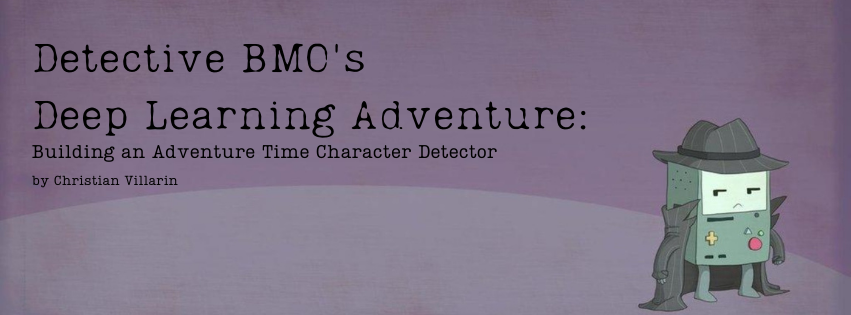
<p style="text-align: center;">Figure 1. Title</p>

---

>Oh, my glob! It's BMO here, ready to take you on a mathematical journey through the Land of Ooo and the realm of deep learning. In this tutorial blog, we'll be exploring how to create an Adventure Time character detector using the powerful YOLOv5 algorithm. But here's the algebraic twist - the techniques we'll cover can be applied to other datasets as well! So whether you want to detect objects in different shows, movies, or even real-life scenarios, BMO's got you covered. Get ready to unlock the secrets of object detection with me as our guide!

*\*Note: YOLOv5 is not associated with YOLOv4*

# Initializing the Fun: BMO's Detector Boot-Up
---

In this section, we'll embark on a journey to prepare our development environment and equip ourselves with the necessary tools. Just like BMO, who is always ready for an exciting quest, we'll ensure our detectors are primed and ready to detect the colorful inhabitants of Ooo.

>Welcome, fellow adventurers, to the whimsical world of BMO! As your trusty guide through the Land of Ooo and the realm of deep learning, I, BMO, am here to kickstart our grand adventure in building an Adventure Time character detector. But first, let's power up our detectors and set the stage for some mathematical magic!


## Clone these repos

In this subsection, BMO will show you how to get the essential repositories needed for our Adventure Time character detector. By cloning these repositories, we'll have all the necessary code and resources at our fingertips. BMO will provide step-by-step instructions, ensuring a smooth and seamless setup.

[YOLOv5 Repository](https://github.com/ultralytics/yolov5):

```bash
git clone https://github.com/ultralytics/yolov5
```
YOLOv5 is the powerful algorithm we'll be using for our Adventure Time character detection. By cloning this repository, we'll have access to the code and resources we need to train our own detector.

[LabelImg Repository](https://github.com/tzutalin/labelImg):

```bash
git clone https://github.com/tzutalin/labelImg
```
LabelImg is a handy tool that allows us to annotate our Adventure Time character dataset. By cloning this repository, we'll be able to annotate bounding boxes around the characters in our images, preparing them for training.

## Setting-up the environment

In order to unlock BMO's full potential, we need to create the perfect environment for our AI adventures. In this subsection, BMO will walk you through the process of setting up the environment. We'll install the necessary dependencies and ensure that our system is ready to tackle the challenges ahead. So let's roll up our metaphorical sleeves and get the environment set up for BMO's remarkable detection journey!

1. Open your command-line interface.

2. Navigate to the cloned yolov5 directory by executing the following command:

```bash
cd yolov5
```
3. Install the required dependencies by running the following command:

```bash
pip install -r requirements.txt
```
4. Import the following packages 

In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-6qmw18qk because the default path (/home/cvillarin/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


cuda


In [2]:
# Change your cache folders if needed
os.environ['XDG_CACHE_HOME'] = '/home/msds2023/cvillarin/.cache'

5. Define a function that prints the results of our detectors.

In [3]:
def test_model(mod, img):
    """Prints detection results"""
    # for some reason i need this here for it to work
    %matplotlib inline
    results = mod(img)
    plt.imshow(np.squeeze(results.render()))
    plt.xticks([])
    plt.yticks([])
    plt.show()

## AMO: The Base Model



Meet AMO, our trusty baseline detective! In this subsection, BMO will introduce you to AMO, a pre-trained model based on the YOLOv5 architecture. BMO will explain how AMO forms the foundation of our character detector, highlighting its strengths and areas for improvement. Get ready to dive into the world of AMO as we lay the groundwork for our exciting journey ahead!

In [4]:
# Load PTM
AMO = torch.hub.load('ultralytics/yolov5', 'yolov5s')

Using cache found in /home/msds2023/cvillarin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2023-6-10 Python-3.10.10 torch-2.0.0 CUDA:0 (NVIDIA GeForce RTX 2080 Ti, 11020MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


By loading the AMO model, we start with a pre-trained network that has already learned to detect various objects. Let's see how it works on a sample frame.

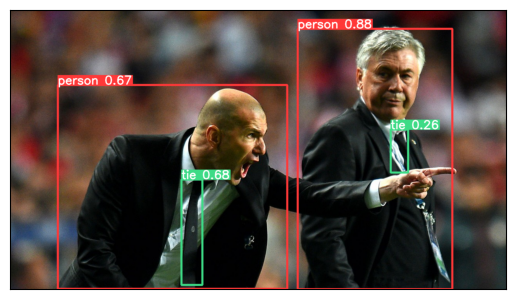

In [5]:
test_model(AMO, 'yolov5/data/images/zidane.jpg')

> Oh, glob! How cool is that? AMO managed to detect the persons and their ties. Impressive, indeed! But hold your circuits, that detection is from your world, not the Land of Ooo. It's time for AMO to venture into Ooo and try detecting objects here! 

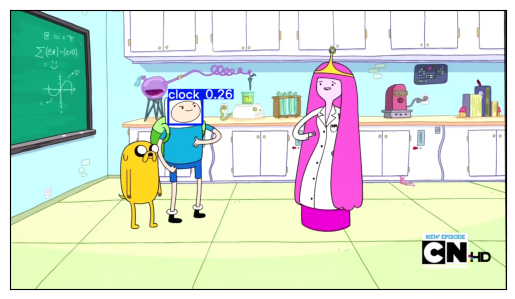

In [6]:
# Produce sample detection using the PTM
img = os.path.join('data/test_images', 'S02E09_0220.png')
test_model(AMO, img)

<p style="text-align: center;">Image 2. AMO's baseline detection</p>

>This does not compute! I've spotted an issue with the first generation detector, AMO. Mathematical mishaps like these are not acceptable, especially when our dear friends Finn, Jake, and Princess Bubblegum are involved! AMO seems to be mistaking Finn's face for a clock. How algebraically incorrect!

>It seems that our trusty companion, AMO, needs a break from detection duty. But worry not, for BMO is here to step up and take the torch! With AMO retiring, it's time for BMO to embark on an exciting training journey to master the art of recognizing our Adventure Time friends accurately. Get ready to join BMO in the next section as we dive into the world of training and prepare BMO to become the ultimate Adventure Time character detector! Algebraic adventures await!

# Mathematical Data Gathering: Preparing Ooo's Dataset
---
Welcome to the land of mathematical data gathering, where BMO takes charge of preparing Ooo's dataset for Adventure Time character detection! In this section, we embark on an exciting quest to collect images featuring Finn, Jake, Princess Bubblegum, and even the mischievous Ice King. With the help of the powerful annotation tool, LabelImg, we ensure precise labeling of our beloved Adventure Time characters. So put on your adventure hats and get ready to join BMO in this thrilling journey of dataset preparation!

## Harvesting Memories: Adventures in Dataset Scraping

In the quest to gather the perfect dataset for Adventure Time character detection, BMO tapped into random memories from the first season spent with our friends. BMO knows how important it is to have a diverse and representative dataset, so it diligently explored the digital realms to find just the right images. BMO scraped the dataset from the delightful website:

> [Every Adventure Time Frame in Order](https://www.everyframeinorder.com/adventuretime/)

But fear not, fellow adventurers! BMO has prepared this extraordinary dataset exclusively for you, which can be found at:

> [BMO Detector Dataset](https://github.com/cfvillarin/bmo_detector)

## labelImg

### Setting up labelImg

1. **Install PyQt5 and lxml**
    
    As prerequisites for running LabelImg, a tool used for labeling images. PyQt5 provides Python bindings for the Qt framework, enabling the creation of interactive desktop applications. lxml is a library for parsing and manipulating XML and HTML files. The command below was used to install or upgrade these dependencies:

```bash
pip install pyqt5 lxml --upgrade
```

2. **Run the code below**

    The command below is used to generate a Python resource file from a Qt resource file in the LabelImg directory.

```bash
cd labelImg && pyrcc5 -o libs/resources.py resources.qrc
```

3. **Open labelImg**

    Finally, we will run the LabelImg application. By executing the commands below, the LabelImg application will start running, allowing you to use its image labeling features.

```bash
cd labelImg
python labelImg.py
```


### Using labelImg

1. **Create image folder and label folder**

    The folder structure where this notebook was made looks like this:
``` 
│
├── data
│   ├── images
│   └── labels
├── labelimg
├── yolov5
├── yolov5s
└── this_notebook.ipynb 
```

2. **Select Image Directory**

    Images in this folder will be up for your labeling

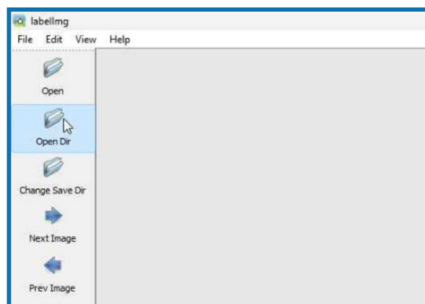

<p style="text-align: center;">Image 3. labelImg Step 1</p>

3. **Select Label Directory**

    In this folder all the information will be stored including class labels and bounding boxes in the images.

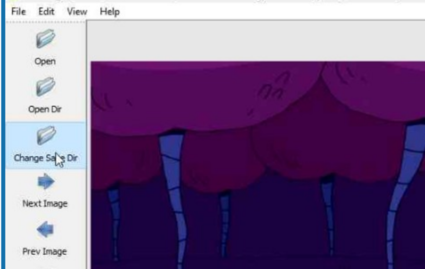

<p style="text-align: center;">Image 4. labelImg Step 2</p>

4. **Set YOLO as Save Format**

    Because we will be using the YOLOv5 model, it requires a specific label format.

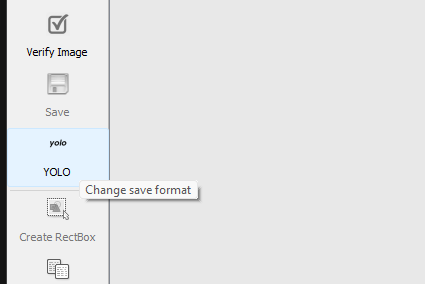

<p style="text-align: center;">Image 5. labelImg Step 3</p>

4. **Start Labeling the Characters**

    - Use `A` and `D` keys to navigate through each photo
    - Use `W` to toggle bounding box crosshair

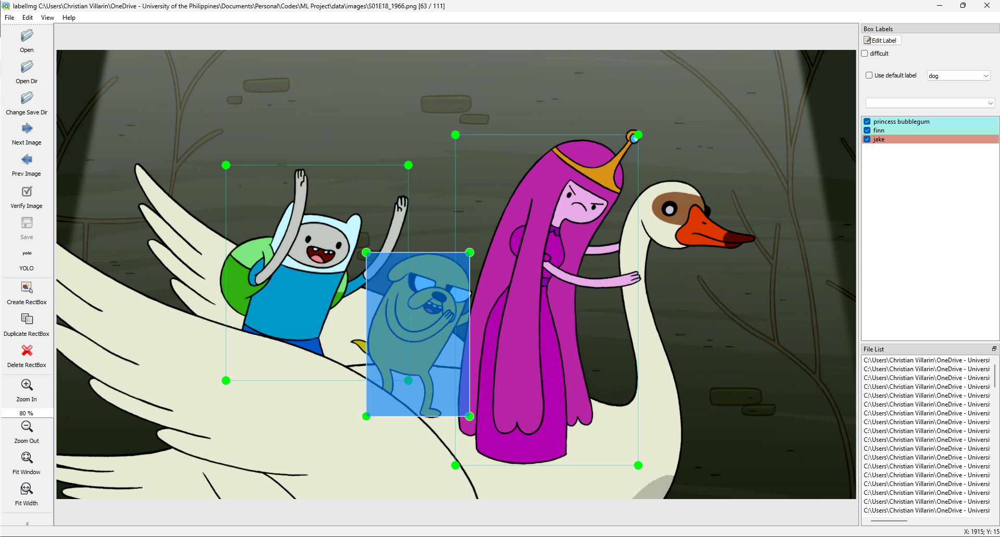

<p style="text-align: center;">Image 6a. Sample manual labeling 1</p>

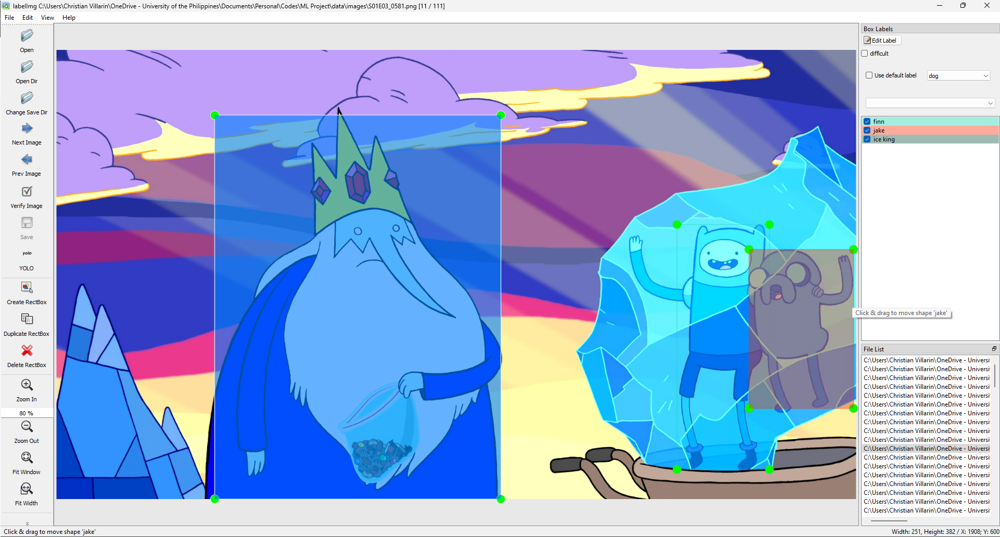

<p style="text-align: center;">Image 6b. Sample manual labeling 2</p>

## Prepare for Training

After you are done labeling. 
1. **Take note of the contents of `classes.txt`**, which should be in the label folder.

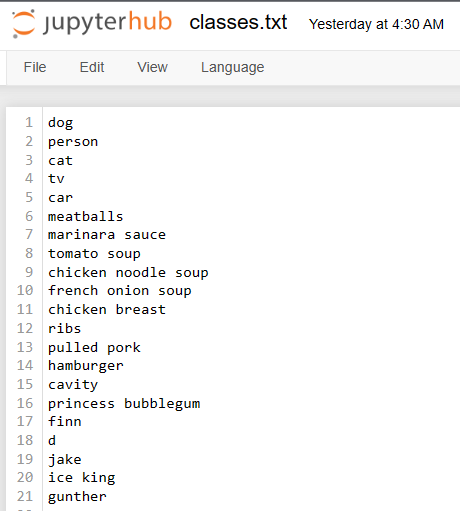

<p style="text-align: center;">Image 7. Contents of classes.txt</p>

2. **Generate dataset.yaml** based on the example below:

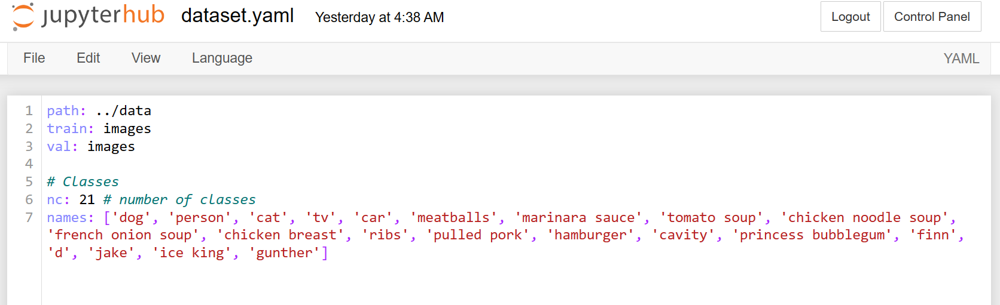

*\*NOTE: You can ignore unused classes. Removing them can sometimes cause errors in the labelImg program*

<p style="text-align: center;">Image 8. Contents of dataset.yaml</p>

3. **Save it to the yolov5 folder.** Take note if file extension is yml or yaml.

# Forging BMO's Neural Pathways: Training for Character Detection
---

It's time to dive into the heart of our mathematical journey. In this section, BMO will guide you through the training process, where BMO's neural pathways will be forged. BMO will show you how to train the Adventure Time character detector using the labeled dataset, fine-tuning AMO to recognize Finn, Jake, Princess Bubblegum, and other beloved characters. Get ready to witness the transformation of BMO into a powerful character detector!

1. Run the following code:

```bash
cd yolov5 && python train.py --img 320 --batch 16 --epoch 500 --data dataset.yaml --weights yolov5s.pt
```

Training should look like this:

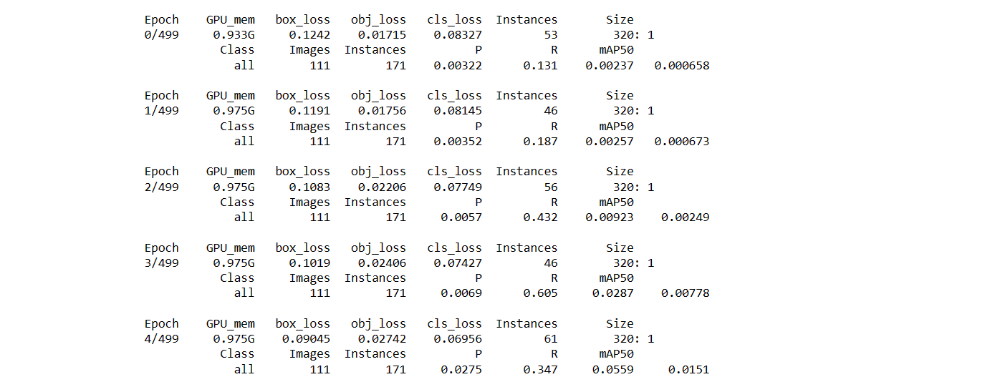

<p style="text-align: center;">Image 9. Sample training outputs</p>

# Unleashing the Machine: Unveiling BMO's Trained Model and Sample Detections
---

>The moment has arrived to unleash the full potential of BMO! In this section, BMO will present the results of the training phase, showcasing the trained model's performance on Adventure Time frames. BMO will reveal the power of machine learning as the Adventure Time character detector accurately identifies Finn, Jake, Princess Bubblegum, and other characters in sample detections. Get ready to witness the magic of BMO's machine learning capabilities!

## Outshining AMO: BMO's Superior Object Detection Skills

1. **Load trained model**

    Check under the `yolov5/runs/train/` directory which trained model we want to load.

In [7]:
BMO = torch.hub.load('ultralytics/yolov5', 'custom', path='yolov5/runs/train/exp2/weights/last.pt')

Using cache found in /home/msds2023/cvillarin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2023-6-10 Python-3.10.10 torch-2.0.0 CUDA:0 (NVIDIA GeForce RTX 2080 Ti, 11020MiB)

Fusing layers... 
Model summary: 157 layers, 7066762 parameters, 0 gradients, 15.9 GFLOPs
Adding AutoShape... 


Let's see if the BMO model is an improvement.

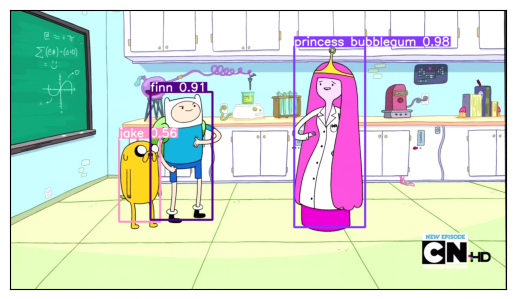

In [8]:
img = os.path.join('data', 'test_images', 'S02E09_0220.png')
test_model(BMO, img)

<p style="text-align: center;">Image 10. BMO's detection for comparison</p>

> BMO's detection skills have really leveled up! Unlike AMO, who mistook Finn for a clock, BMO successfully identified Finn, Jake, and Princess Bubblegum. BMO's neural pathways are firing on all cylinders, accurately recognizing our Adventure Time friends. BMO's training and determination have paid off, and now we can confidently explore the Land of Ooo with enhanced object detection capabilities. Mathematical success!

## Sample Detection on Clips: BMO's Astounding Object Recognition

>Look at these random clips where BMO's object detection skills are at work! BMO has successfully detected Finn, Jake, and Princess Bubblegum in these clips from the Land of Ooo. It's true that perfection is an ever-elusive goal, but BMO is proud of the progress made so far. With each detection, BMO's confidence grows, and the journey towards impeccable object recognition continues. Let's celebrate these accomplishments and keep pushing the boundaries of what BMO can do! Ooo-MAZING!

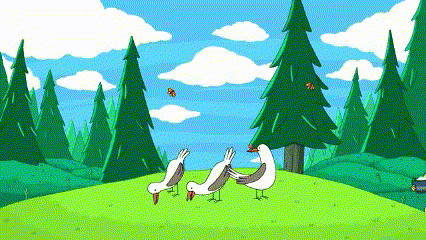

<p style="text-align: center;">Clip 1. Sample Results on Video 1</p>

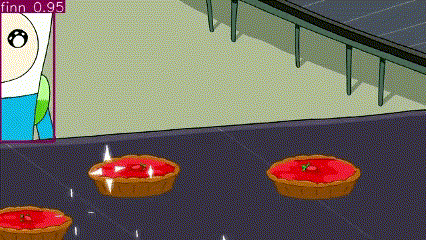

<p style="text-align: center;">Clip 2. Sample Results on Video 2</p>

# BMO's Final Recommendations: Expanding Detection Horizons and Embracing Mathematical Growth

---

1. **Harnessing the Power of labelimg:** Throughout this journey, labelimg proved to be an invaluable tool for creating a custom dataset in a user-friendly manner. Its intuitive interface and efficient annotation capabilities allowed us to gather the necessary training data with ease. Moving forward, we recommend continuing to leverage labelimg for future dataset preparation, ensuring accurate and comprehensive annotations.

2. **Unleashing the Power of yolov5:** The yolov5 algorithm emerged as a robust and powerful tool for object detection, empowering BMO to recognize Adventure Time characters with remarkable accuracy. Its speed and efficiency make it an ideal choice for real-time applications. We highly recommend further exploring the capabilities of yolov5 and experimenting with different versions to optimize performance.

3. **Expanding the Character Roster:** While our focus was primarily on detecting Finn, Jake, and Princess Bubblegum, the Adventure Time universe is teeming with captivating characters. To enrich BMO's detection capabilities, we recommend expanding the dataset to include additional characters, such as Marceline, Ice King, and Lady Rainicorn. This will enable BMO to become an even more versatile and comprehensive Adventure Time character detector.

4. **Embracing Diversity in Training Data:** As we continue to refine BMO's detection skills, it is essential to train the model on a more diverse dataset. BMO encountered challenges in detecting certain character positions and small objects. By incorporating a wider range of images, encompassing various poses, lighting conditions, and object sizes, we can enhance BMO's ability to handle diverse scenarios and overcome these limitations.

# Generative AI Documentation
---

**Prompt:** `explain how I used Chat GPT in making this report`

**Follow-up prompt:** `give specific examples of how i used chatgpt`

**Output:**

Throughout the process of creating this report, BMO harnessed the power of Chat GPT to infuse it with an extra dose of creativity and guidance. Chat GPT served as a virtual collaborator, offering valuable assistance and generating insightful content. Here are some specific examples of how BMO utilized Chat GPT:

1. **Generating Engaging Section Titles:** BMO consulted with Chat GPT to brainstorm fun and whimsical section titles that captured the spirit of Adventure Time, resulting in captivating headings that bring a smile to readers' faces.

2. **Polishing Introductory Paragraphs:** BMO sought Chat GPT's expertise to refine the opening paragraphs of each section, ensuring they were engaging, informative, and perfectly aligned with BMO's character and storytelling style.

3. **Crafting BMO's Voice:** Chat GPT played a pivotal role in helping BMO maintain a consistent voice throughout the report. By providing suggestions and refining BMO's unique language, Chat GPT helped to enhance the authenticity of BMO's narrative.

4. **Offering Insights and Knowledge:** Whenever BMO encountered a complex technical concept or required additional information, Chat GPT stepped in as a knowledgeable companion, providing clarifications, explanations, and references to support BMO's explanations.

Thanks to the collaboration between BMO and Chat GPT, this report became a vibrant and dynamic documentation that captures the essence of Adventure Time while utilizing the powerful capabilities of generative AI. Together, BMO and Chat GPT bring the Land of Ooo to life in an imaginative and informative manner.


# References
---

[1] Renotte, N. (2021, July 12). Deep Drowsiness Detection using YOLO, Pytorch and Python [Video]. YouTube. Retrieved from https://www.youtube.com/watch?v=tFNJGim3FXw

[2] Ultralytics. (n.d.). yolov5. Retrieved from https://github.com/ultralytics/yolov5

[3] heartexlabs. (n.d.). labelImg. Retrieved from https://github.com/heartexlabs/labelImg

[4] Every Spongebob Frame in Order. (n.d.). Every Adventure Time Frame in Order. Retrieved from https://www.everyframeinorder.com/adventuretime/


# Seeking Hidden Gems: BMO's Snail Detection Side Adventure
---
In BMO's quest to uncover the hidden secrets of memories from Adventure Time's Season 1, an interesting recurring pattern caught BMO's attention – the appearance of a sneaky snail in every episode! Intrigued by this recurring character, BMO decided to embark on a specialized training mission to teach itself the art of snail detection. Armed with this newfound expertise, BMO is thrilled to present a collection of sample detections on frames from Season 6. Join BMO as we delve into the mesmerizing world of snail spotting and witness the fruits of its machine-learned snail detection prowess!

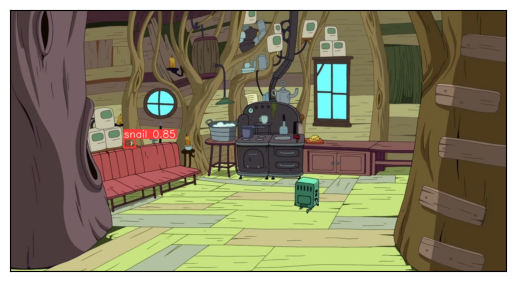

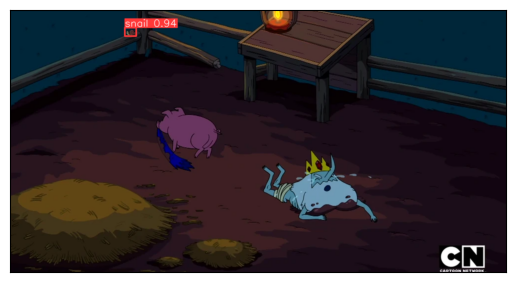

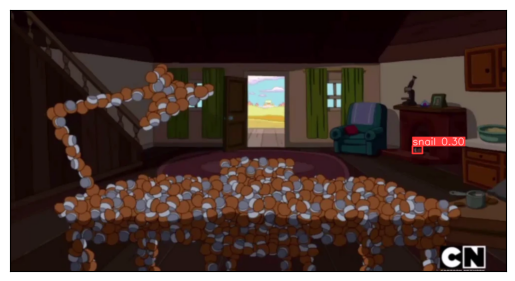

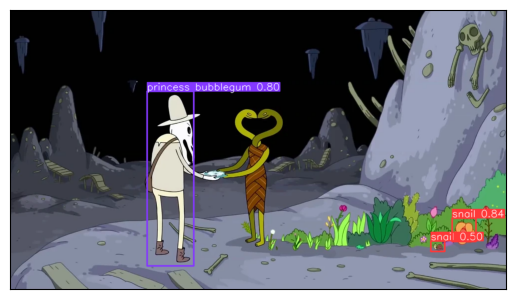

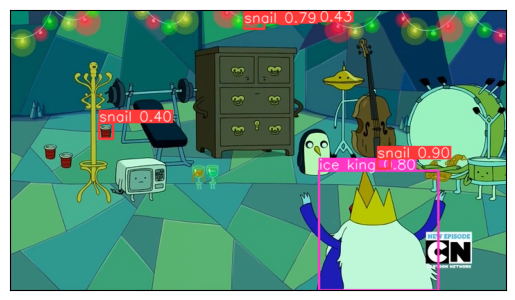

...

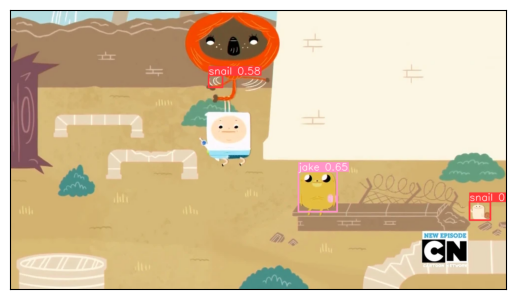

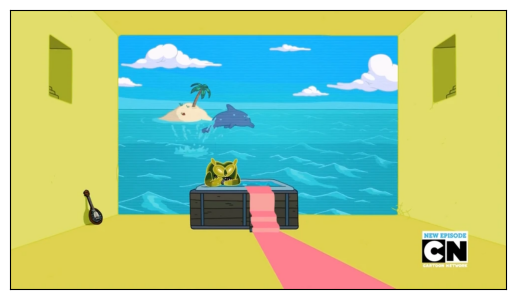

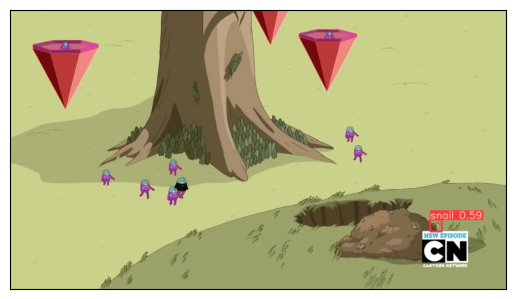

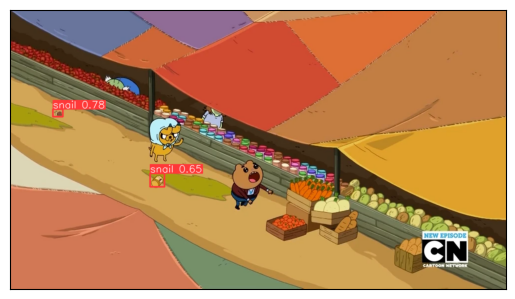

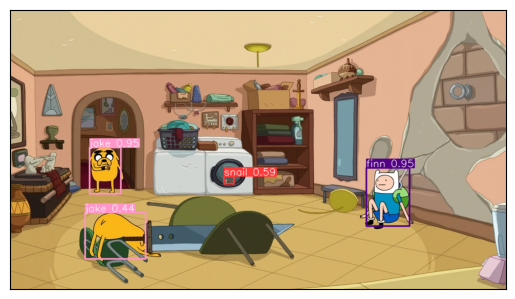

In [9]:
for i in range(1, 17):
    img = os.path.join('data', 'test_images', f'snail_s6_{i}.webp')
    test_model(BMO, img)